# Homework2 Face Generation
In HW2, You'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using CelebA datasets in this homework, we provide the code for you to download the dataset and preprocess data

In [1]:
import os
import helper
import matplotlib.pyplot as plt
%matplotlib inline
from glob import glob

In [2]:
data_dir = './data'
helper.download_extract(data_dir)

Found celeba Data


### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

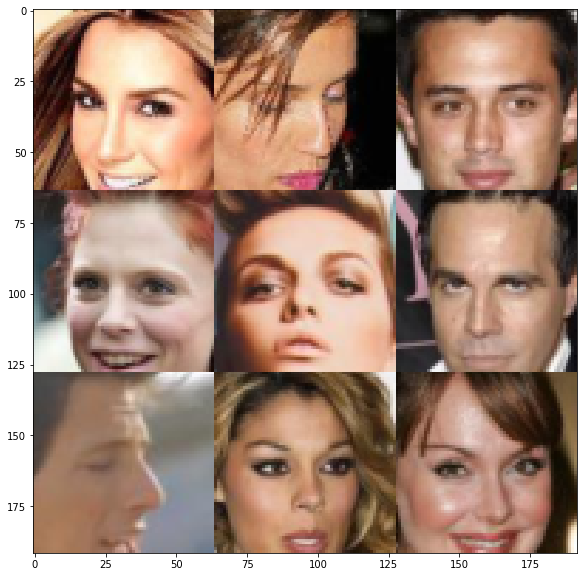

In [3]:
show_n_images = 9
image_size = 64
plt.figure(figsize=(10, 10))
images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], image_size, image_size, 'RGB')
plt.imshow(helper.images_square_grid(images))
plt.show()

### Load Training Dataset (by helper.py)

In [4]:
X_train = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:], image_size, image_size, 'RGB')
X_train.shape

(202599, 64, 64, 3)

## WGAN-GP
https://github.com/eriklindernoren/Keras-GAN/blob/master/wgan_gp/wgan_gp.py

https://github.com/keras-team/keras-contrib/blob/master/examples/improved_wgan.py

https://github.com/changwoolee/WGAN-GP-tensorflow

In [5]:
from keras.layers.merge import _Merge
from keras.layers import Input, Dense, Reshape, Flatten, Dropout
from keras.layers import BatchNormalization, Activation, Conv2DTranspose
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import Conv2D
from keras.models import Sequential, Model
from keras.optimizers import Adam
from functools import partial

import keras.backend as K

import sys

import numpy as np

Using TensorFlow backend.


In [6]:
# images size
img_rows = 64
img_cols = 64
channels = 3
img_shape = (img_rows, img_cols, channels)

latent_dim = 100
batch_size = 64

BN_momentum = 0.9
BN_epsilon = 1e-5
leaky_relu_alpha = 0.2
learning_rate = 1e-4
adam_beta1 = 0
adam_beta2 = 0.9

epochs = 150

# n_critic is the number of discriminator updates per generator update. The paper uses 5.
n_critic = 5
#sample_interval = 50

### Calculates the Wasserstein loss for a sample batch.
    The Wasserstein loss function is very simple to calculate. In a standard GAN, the
    discriminator has a sigmoid output, representing the probability that samples are
    real or generated. In Wasserstein GANs, however, the output is linear with no
    activation function! Instead of being constrained to [0, 1], the discriminator wants
    to make the distance between its output for real and generated samples as
    large as possible.
    
    The most natural way to achieve this is to label generated samples -1 and real
    samples 1, instead of the 0 and 1 used in normal GANs, so that multiplying the
    outputs by the labels will give you the loss immediately.
    Note that the nature of this loss means that it can be (and frequently will be)
    less than 0.

In [7]:
def wasserstein_loss(y_true, y_pred):
    return K.mean(y_true * y_pred)


### Calculates the gradient penalty loss for a batch of "averaged" samples.
    In Improved WGANs, the 1-Lipschitz constraint is enforced by adding a term to the
    loss function that penalizes the network if the gradient norm moves away from 1.
    However, it is impossible to evaluate this function at all points in the input
    space. The compromise used in the paper is to choose random points on the lines
    between real and generated samples, and check the gradients at these points. Note
    that it is the gradient w.r.t. the input averaged samples, not the weights of the
    discriminator, that we're penalizing!
    In order to evaluate the gradients, we must first run samples through the generator
    and evaluate the loss. Then we get the gradients of the discriminator w.r.t. the
    input averaged samples. The l2 norm and penalty can then be calculated for this
    gradient.
    Note that this loss function requires the original averaged samples as input, but
    Keras only supports passing y_true and y_pred to loss functions. To get around this,
    we make a partial() of the function with the averaged_samples argument, and use that
    for model training.

In [8]:
def gradient_penalty_loss(y_true, y_pred, averaged_samples):
    """
    Computes gradient penalty based on prediction and weighted real / fake samples
    """
    gradients = K.gradients(y_pred, averaged_samples)[0]
    # compute the euclidean norm by squaring ...
    gradients_sqr = K.square(gradients)
    #   ... summing over the rows ...
    gradients_sqr_sum = K.sum(gradients_sqr, axis=np.arange(1, len(gradients_sqr.shape)))
    #   ... and sqrt
    gradient_l2_norm = K.sqrt(gradients_sqr_sum)
    # compute lambda * (1 - ||grad||)^2 still for each single sample
    gradient_penalty = K.square(1 - gradient_l2_norm)
    # return the mean as loss over all the batch samples
    return K.mean(gradient_penalty)

In [9]:
class RandomWeightedAverage(_Merge):
    """
    Provides a (random) weighted average between real and generated image samples
    """
    def _merge_function(self, inputs):
        alpha = K.random_uniform((batch_size, 1, 1, 1))
        return (alpha * inputs[0]) + ((1 - alpha) * inputs[1])

In [10]:
def build_generator():
    """
    Creates a generator model that takes a 100-dimensional noise vector as a "seed", and outputs images of size 64x64x3.
    """
    model = Sequential()

    model.add(Dense(512 * 4 * 4, activation="relu", input_dim=latent_dim))
    model.add(Reshape((4, 4, 512)))
    model.add(BatchNormalization(momentum=BN_momentum, epsilon=BN_epsilon))
    model.add(Activation("relu"))
    
    #model.add(UpSampling2D())
    #model.add(Conv2D(256, kernel_size=5, padding="same"))
    model.add(Conv2DTranspose(256, kernel_size=5, strides=(2, 2), padding='same'))
    model.add(BatchNormalization(momentum=BN_momentum, epsilon=BN_epsilon))
    model.add(Activation("relu"))
    
    #model.add(UpSampling2D())
    #model.add(Conv2D(128, kernel_size=5, padding="same"))
    model.add(Conv2DTranspose(128, kernel_size=5, strides=(2, 2), padding='same'))
    model.add(BatchNormalization(momentum=BN_momentum, epsilon=BN_epsilon))
    model.add(Activation("relu"))
    
    #model.add(UpSampling2D())
    #model.add(Conv2D(64, kernel_size=5, padding="same"))
    model.add(Conv2DTranspose(64, kernel_size=5, strides=(2, 2), padding='same'))
    model.add(BatchNormalization(momentum=BN_momentum, epsilon=BN_epsilon))
    model.add(Activation("relu"))
   
    #model.add(UpSampling2D())
    model.add(Conv2DTranspose(channels, kernel_size=5, strides=(2, 2), padding='same'))
    
    # Because we normalized training inputs to lie in the range [-1, 1],
    # the tanh function should be used for the output of the generator to ensure
    # its output also lies in this range.
    model.add(Activation("tanh"))

    model.summary()

    noise = Input(shape=(latent_dim,))
    img = model(noise)

    return Model(noise, img)

### The Discriminator

In [11]:
def build_critic():
    """
    Creates a discriminator model that takes an image as input and outputs a single
    value, representing whether the input is real or generated. Unlike normal GANs, the
    output is not sigmoid and does not represent a probability! Instead, the output
    should be as large and negative as possible for generated inputs and as large and
    positive as possible for real inputs.
    Note that the improved WGAN paper suggests that BatchNormalization should not be
    used in the discriminator.
    """    
    model = Sequential()

    model.add(Conv2D(64, kernel_size=5, strides=2, input_shape=img_shape, padding="same"))
    model.add(LeakyReLU(alpha=leaky_relu_alpha))
    #model.add(Dropout(0.8))
    model.add(Conv2D(128, kernel_size=5, strides=2, padding="same"))
    #model.add(ZeroPadding2D(padding=((0,1),(0,1))))
    #model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=leaky_relu_alpha))
    #model.add(Dropout(0.8))
    model.add(Conv2D(256, kernel_size=5, strides=2, padding="same"))
    #model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=leaky_relu_alpha))
    #model.add(Dropout(0.8))
    model.add(Conv2D(512, kernel_size=5, strides=2, padding="same"))
    #model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=leaky_relu_alpha))
    #model.add(Dropout(0.8))
    model.add(Flatten())
    model.add(Dense(1))

    model.summary()

    img = Input(shape=img_shape)
    validity = model(img)

    return Model(img, validity)

In [12]:
# Following parameter and optimizer set as recommended in paper
optimizer = Adam(lr=learning_rate, beta_1=adam_beta1, beta_2=adam_beta2)
#optimizer = RMSprop(lr=0.00005)

# Build the generator and critic
generator = build_generator()
critic = build_critic()

#-------------------------------
# Construct Computational Graph
#       for the Critic
#-------------------------------

# Freeze generator's layers while training critic
generator.trainable = False

# Image input (real sample)
real_img = Input(shape=img_shape)

# Noise input
z_disc = Input(shape=(latent_dim,))
# Generate image based of noise (fake sample)
fake_img = generator(z_disc)

# Discriminator determines validity of the real and fake images
fake = critic(fake_img)
valid = critic(real_img)

# Construct weighted average between real and fake images
interpolated_img = RandomWeightedAverage()([real_img, fake_img])
# Determine validity of weighted sample
validity_interpolated = critic(interpolated_img)

# Use Python partial to provide loss function with additional
# 'averaged_samples' argument
partial_gp_loss = partial(gradient_penalty_loss, averaged_samples=interpolated_img)
partial_gp_loss.__name__ = 'gradient_penalty' # Keras requires function names

critic_model = Model(inputs=[real_img, z_disc], outputs=[valid, fake, validity_interpolated])
critic_model.compile(loss=[wasserstein_loss, wasserstein_loss, partial_gp_loss], optimizer=optimizer, loss_weights=[1, 1, 10])
#-------------------------------
# Construct Computational Graph
#         for Generator
#-------------------------------

# For the generator we freeze the critic's layers
critic.trainable = False
generator.trainable = True

# Sampled noise for input to generator
z_gen = Input(shape=(latent_dim,))
# Generate images based of noise
img = generator(z_gen)
# Discriminator determines validity
valid = critic(img)
# Defines generator model
generator_model = Model(z_gen, valid)
generator_model.compile(loss=wasserstein_loss, optimizer=optimizer)







Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 8192)              827392    
_________________________________________________________________
reshape_1 (Reshape)          (None, 4, 4, 512)         0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 4, 4, 512)         2048      
_________________________________________________________________
activation_1 (Activation)    (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 8, 8, 256)         3277056   
_________________________________________________________________
batch_normalization_2 (Batch (None, 8, 8, 256)         1024      
_________________________________________________________________
activation_2 (Activation)    (None, 8, 8, 256)  

In [13]:
def sample_images_same_weights(epoch):
    r, c = 5, 5
    np.random.seed(856621)
    noise = np.random.normal(0, 1, (r * c, latent_dim))
    gen_imgs = generator.predict(noise)

    # Rescale images 0 - 1
    gen_imgs = 0.5 * gen_imgs + 0.5

    fig, axs = plt.subplots(r, c)
    cnt = 0
    for i in range(r):
        for j in range(c):
            axs[i,j].imshow(gen_imgs[cnt, :,:,:])
            axs[i,j].axis('off')
            cnt += 1
    fig.savefig("images_same_weights/Celeba_%d.png" % epoch)
    plt.close()

In [14]:
def sample_images(epoch):
    """
    Feeds random seeds into the generator and tiles and saves the output to a PNG
    file.
    """
    r, c = 5, 5
    np.random.seed(None)
    noise = np.random.normal(0, 1, (r * c, latent_dim))
    gen_imgs = generator.predict(noise)

    # Rescale images 0 - 1
    gen_imgs = 0.5 * gen_imgs + 0.5

    fig, axs = plt.subplots(r, c)
    cnt = 0
    for i in range(r):
        for j in range(c):
            axs[i,j].imshow(gen_imgs[cnt, :,:,:])
            axs[i,j].axis('off')
            cnt += 1
    fig.savefig("images/Celeba_%d.png" % epoch)
    plt.close()

In [15]:
import time


# Adversarial ground truths
#valid = -(np.random.random(size=(batch_size,1))*0.5+0.7)
valid = np.ones((batch_size, 1), dtype=np.float32)
#fake =  np.random.random(size=(batch_size,1))*0.5+0.7
fake = -valid
#dummy = np.random.random(size=(batch_size,1))*0.3 # Dummy gt for gradient penalty
dummy = np.zeros((batch_size, 1), dtype=np.float32)
start = time.time()
for epoch in range(epochs):
    for i in range(int(X_train.shape[0] // (batch_size * 5))):
        for _ in range(n_critic):

            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Select a random batch of images
            np.random.seed(None)
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]
            
            # Normalize data to the range [-1, 1]
            imgs = imgs/127.5 - 1
            
            # Sample generator input
            noise = np.random.normal(0, 1, (batch_size, latent_dim))
            # Train the critic
            d_loss = critic_model.train_on_batch([imgs, noise], [valid, fake, dummy])

        # ---------------------
        #  Train Generator
        # ---------------------

        g_loss = generator_model.train_on_batch(noise, valid)

        # Plot the progress
    print ("%d [D loss: %f] [G loss: %f]" % (epoch, d_loss[0], g_loss))

    # If at save interval => save generated image samples
    #if epoch % sample_interval == 0:
    sample_images(epoch)
    sample_images_same_weights(epoch)
    generator_model.save('./60000/60000_gmodel_%d.h5' % (epoch))
    critic_model.save('./60000/60000_cmodel_%d.h5' % (epoch))
    generator_model.save_weights('./60000/60000_gweights_%d.h5' % (epoch))
    critic_model.save_weights('./60000/60000_dweights_%d.h5' % (epoch))
    
end = time.time() - start
print('Total Time: %d\f' % (end))

C:\Users\YanRoo\Anaconda3\envs\Keras\lib\site-packages\keras\engine\training.py:493: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


C:\Users\YanRoo\Anaconda3\envs\Keras\lib\site-packages\keras\engine\training.py:493: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'
C:\Users\YanRoo\Anaconda3\envs\Keras\lib\site-packages\keras\engine\training.py:493: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: -9.666269] [G loss: -14.516052]
1 [D loss: -5.081537] [G loss: -9.798887]
2 [D loss: -5.973087] [G loss: -7.173952]
3 [D loss: -5.288841] [G loss: -2.643701]
4 [D loss: -5.131158] [G loss: -1.248011]
5 [D loss: -3.726751] [G loss: 2.512132]
6 [D loss: -3.454303] [G loss: -0.387438]
7 [D loss: -4.886054] [G loss: 1.436681]
8 [D loss: -4.290843] [G loss: -0.624612]
9 [D loss: -3.849864] [G loss: -3.724274]
10 [D loss: -3.410953] [G loss: -0.150368]
11 [D loss: -3.088942] [G loss: -1.921006]
12 [D loss: -3.487252] [G loss: 0.618750]
13 [D loss: -3.335938] [G loss: -1.778579]
14 [D loss: -3.312440] [G loss: 1.873958]
15 [D loss: -2.740729] [G loss: 3.698603]
16 [D loss: -2.868748] [G loss: 3.508466]
17 [D loss: -3.157172] [G loss: -1.857779]
18 [D loss: -2.832721] [G loss: 6.365974]
19 [D loss: -2.576390] [G loss: 3.988182]
20 [D loss: -2.245409] [G loss: 2.068817]
21 [D loss: -2.463752] [G loss: 1.658873]
22 [D loss: -2.388382] [G loss: 4.959294]
23 [D loss: -2.133205] [G loss:

In [25]:
def output_fig(images_array, file_name="./results"):
    plt.figure(figsize=(6, 6), dpi=100)
    plt.imshow(helper.images_square_grid(images_array))
    plt.axis("off")
    plt.savefig(file_name+'.png', bbox_inches='tight', pad_inches=0)

C:\Users\YanRoo\Anaconda3\envs\Keras\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


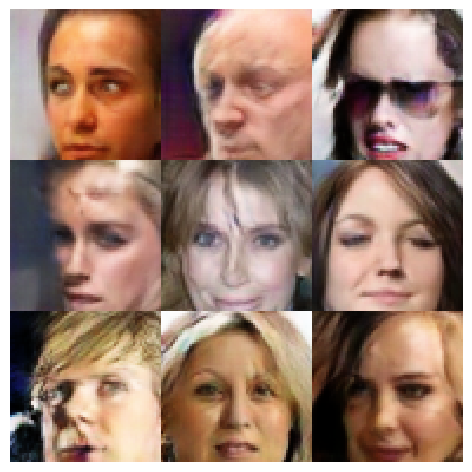

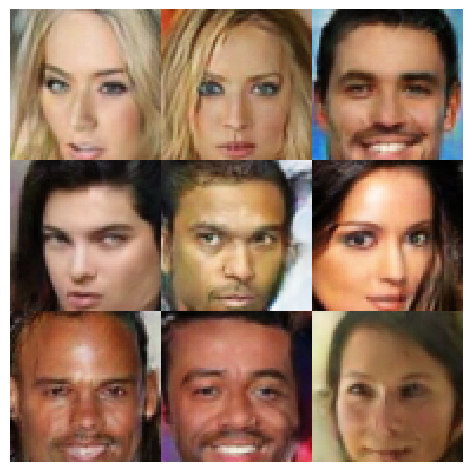

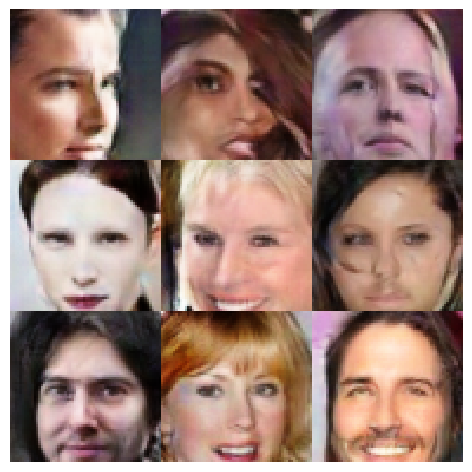

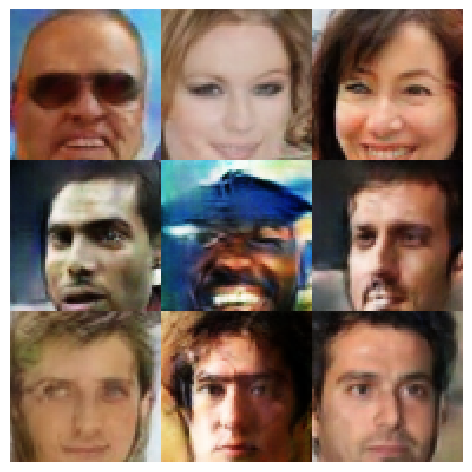

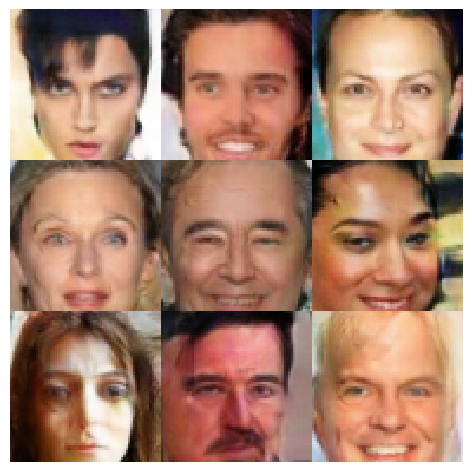

...

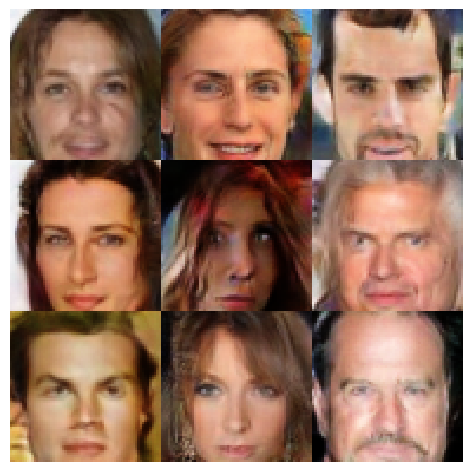

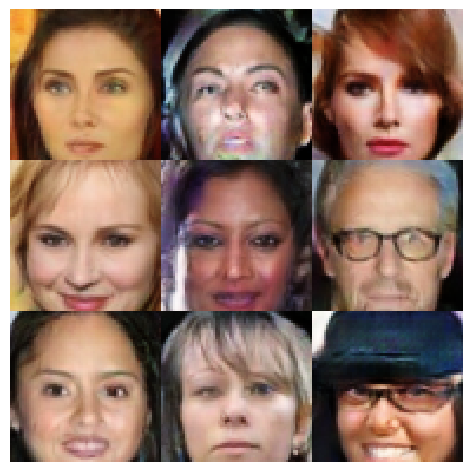

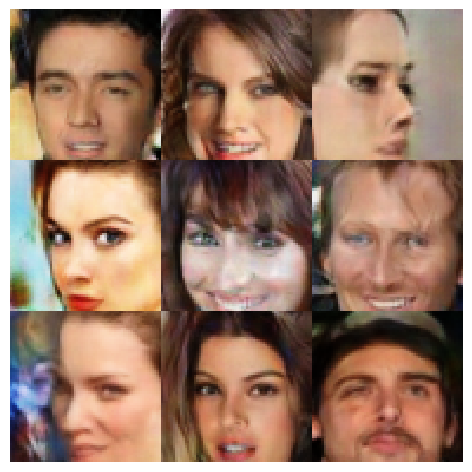

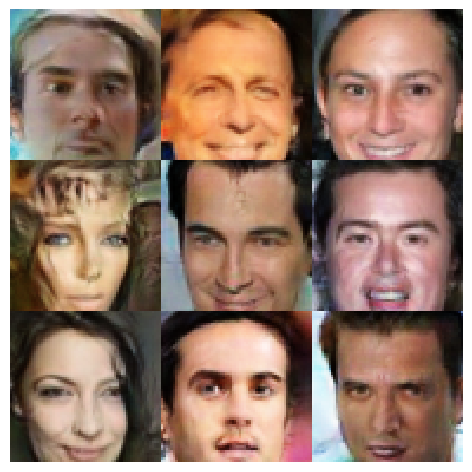

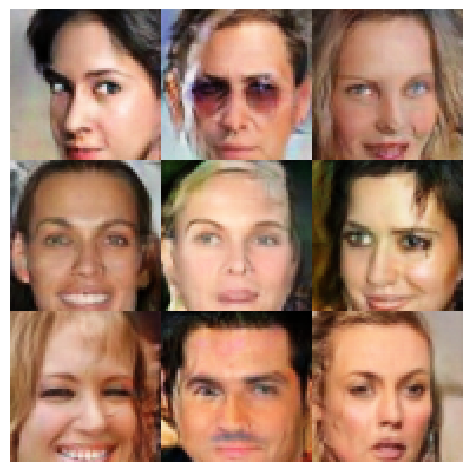

In [ ]:
for i in range(500):
    noise = np.random.normal(0, 1, (3 * 3, latent_dim))
    gen_imgs = generator.predict(noise)
    output_fig(gen_imgs, file_name="./results/%.3d_image" %i)

### Create a Gif

In [22]:
import imageio
import glob
from IPython import display

anim_file = 'wgan-gp.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('./images_same_weights/Celeba_*.png')
  filenames = sorted(filenames)
  last = -1
  for i,filename in enumerate(filenames):
    frame = 2*(i**0.5)
    if round(frame) > round(last):
      last = frame
    else:
      continue
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

import IPython
if IPython.version_info > (6,2,0,''):
  display.Image(filename=anim_file)

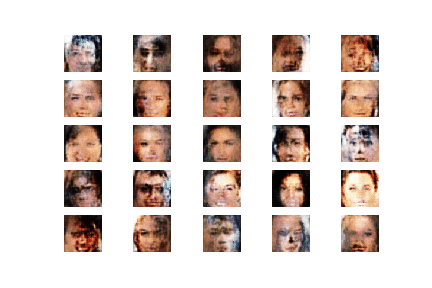

In [23]:
display.Image(filename=anim_file)